In [15]:
### Import libraries

import pandas as pd
import igraph as ig
import auxiliar_path
import numpy as np
import matplotlib.pyplot as plt

In [4]:
### Global variables
### Global variables

DATASET = "AMZ" # AMZ, HC, PM, UN, TOY
NODE_TYPE = False

PATH_DATASET = auxiliar_path.get_path_dataset(DATASET)
PATH_NODETYPE = auxiliar_path.get_path_topbot(NODE_TYPE)

GLOBAL_PATH = "/Users/ddiaz/Documents/code/phd-thesis-lab/"

# File CSV
FILENAME = GLOBAL_PATH + "12-third_year/00-Data/"+PATH_DATASET+"/01-DistributionsCSV/"+DATASET+"-Rw.csv"

In [5]:
### Read CSV

df = pd.read_csv(FILENAME)

# Remove noisy column
df = df.drop(columns=["Unnamed: 0"])
print(df.info()) # Info
print()

# Obtener identificadores únicos por tipo
unique_source = sorted(df['uname'].unique())  # Nodos tipo 1
unique_target = sorted(df['rname'].unique())  # Nodos tipo 2

# Crear nuevo mapeo de IDs
source_mapping = {old_id: new_id for new_id, old_id in enumerate(unique_source)}
start_target_id = len(unique_source)  # El primer ID del target será el último del source + 1
target_mapping = {old_id: new_id for new_id, old_id in enumerate(unique_target, start=start_target_id)}

# Aplicar el mapeo al dataframe
df_mapped = df.replace({'uname': source_mapping, 'rname': target_mapping})

# Contar la frecuencia correcta después del mapeo
source_counts = df_mapped['uname'].value_counts().to_dict()
target_counts = df_mapped['rname'].value_counts().to_dict()

# Fusionar ambas frecuencias.
node_frequencies = {node: source_counts.get(node, 0) + target_counts.get(node, 0) for node in range(len(source_mapping) + len(target_mapping))}

# Contar la frecuencia de cada arista después del mapeo
edge_counts = df_mapped.groupby(['uname', 'rname']).size().to_dict()

# Some information about access requests
n_user = len(df_mapped.uname.drop_duplicates())
n_rscs = len(df_mapped.rname.drop_duplicates())
print(f"|U| = {n_user}")
print(f"|R| = {n_rscs}")
print(f"|U+R| = {n_user+n_rscs}")
print()

# Possible edges
n_acc_res = len(df_mapped.drop_duplicates(["uname", "rname"]))
df_pos = df_mapped[df_mapped.ACTION == 1]
n_ar_pos = len(df_pos.drop_duplicates())
n_ar_neg = len(df_mapped[df_mapped.ACTION == 0].drop_duplicates())

print(f"|L| = {n_acc_res}")
print(f"|L+| = {n_ar_pos}")
print(f"|L-| = {n_ar_neg}")
print()

if n_acc_res == n_ar_pos+n_ar_neg:
    print("*"*43)
    print("** CORRECT FLAG: Same number L = L+ + L- **")
    print("*"*43)

### Generate bipartite graph

# Crear el grafo bipartito en igraph
edges = list(edge_counts.keys())  # Lista de aristas sin duplicados
g = ig.Graph(edges=edges, directed=False)

# Etiquetar los nodos con su tipo
g.vs['type'] = [0] * len(source_mapping) + [1] * len(target_mapping)  # 0 para tipo 1, 1 para tipo 2

# Agregar el atributo de frecuencia de los nodos
g.vs['frequency'] = [node_frequencies[node] for node in range(len(g.vs))]

# Agregar el atributo de peso a las aristas
g.es['weight'] = [edge_counts[edge] for edge in edges]

# Number of nodes
print(g.summary())
print(f"|V| = {g.vcount()}")
print(f"|U| = {len(g.vs.select(type_eq=0))}")
print(f"|R| = {len(g.vs.select(type_eq=1))}")
print(f"|E| = {g.ecount()}")
print(f"Is bipartite = {g.is_bipartite()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 65538 entries, 0 to 65537
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype
---  ------            --------------  -----
 0   ACTION            65538 non-null  int64
 1   rname             65538 non-null  int64
 2   MGR_ID            65538 non-null  int64
 3   ROLE_ROLLUP_1     65538 non-null  int64
 4   ROLE_ROLLUP_2     65538 non-null  int64
 5   ROLE_DEPTNAME     65538 non-null  int64
 6   ROLE_TITLE        65538 non-null  int64
 7   ROLE_FAMILY_DESC  65538 non-null  int64
 8   ROLE_FAMILY       65538 non-null  int64
 9   ROLE_CODE         65538 non-null  int64
 10  uname             65538 non-null  int64
dtypes: int64(11)
memory usage: 5.5 MB
None

|U| = 9561
|R| = 7518
|U+R| = 17079

|L| = 32769
|L+| = 30872
|L-| = 1897

*******************************************
** CORRECT FLAG: Same number L = L+ + L- **
*******************************************
IGRAPH U-WT 17079 32769 -- 
+ attr: frequency (v), typ

In [155]:
### GLOBAL variables

CSV_PATH = "../00-Data/01-AMZ/01-DistributionsCSV/AMZ-Rw.csv"
GRAPH_PATH = "/Users/ddiaz/Documents/code/phd-thesis-lab/12-third_year/00-Data/01-AMZ/02-Graphs/02-Bot/AMZ_bot_hyperbolic_noise_alpha15.graphml"

In [156]:
### Read GRAPH

g = ig.read(GRAPH_PATH)
print(g.summary(), "\n")

print("Graph info:")
print("\t|V| =", g.vcount())
print("\t|E| =", g.ecount())
print("\t d  =", g.density())

IGRAPH U-W- 7226 60540 -- 
+ attr: id (v), weight (e) 

Graph info:
	|V| = 7226
	|E| = 60540
	 d  = 0.002319191462586565


In [165]:
### K-modes algorithm
from kmodes import KModes

# Select the number of clusters###
num_clusters = 30

#DO NOT CHANGE THIS CODE
# seed = 29

#Compute centroids and labels
# num_init = 5
centroids = []
kmodes_huang = KModes(n_clusters=num_clusters, init='Huang', verbose=0)
cluster_labels = kmodes_huang.fit_predict(df_pos.drop(columns=["rname", "uname"]))
centroids = kmodes_huang.cluster_centroids_
df_pos["cls"] = cluster_labels
print('Ready!')   

Ready!


/var/folders/g4/vgr09c9n7pd31lk61zpr3_440000gn/T/ipykernel_1854/984631308.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pos["cls"] = cluster_labels


In [166]:
len(df_pos["cls"].value_counts())

30

In [9]:
### Implementar la función para obtener todos los vecinos

def get_neis(data):
    """Get the nodes in the same cluster."""
    dict_user = dict()
    dict_res = dict()
    for user in data.uname.drop_duplicates():
        all_clusters = set(data[data.uname==user]["cls"])
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["uname"]))
        dict_user[user] = neis_user
    
    for res in data.rname.drop_duplicates():
        all_clusters = set(data[data.rname==res]["cls"])
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["rname"]))
        dict_res[res] = neis_user
    
    return dict_user, dict_res

dict_user, dict_res = get_neis(df_pos)

In [167]:
### Community Detection

comms = g.community_multilevel(weights=g.es["weight"])
g.vs["cls"] = comms.membership
print(comms.summary(), "\n")

Clustering with 7226 elements and 340 clusters 



In [168]:
comms_with_one = [i for i, subgraph in enumerate(comms.subgraphs()) if len(subgraph.vs) > 5]
len(comms_with_one)

29

<Figure size 640x480 with 0 Axes>

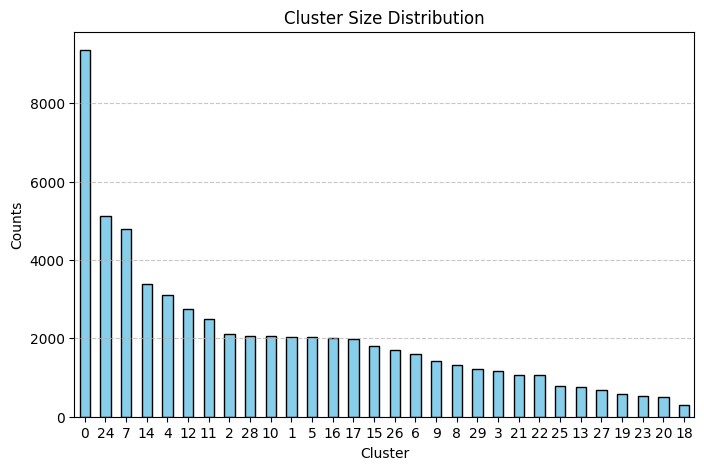

In [169]:
plt.clf()

value_counts = df_pos["cls"].value_counts()
# Plot
plt.figure(figsize=(8, 5))
value_counts.plot(kind='bar', color='skyblue', edgecolor='black')
plt.xlabel('Cluster')
plt.ylabel('Counts')
plt.title('Cluster Size Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.show()

In [182]:
# Obtener la cantidad de usuarios por nodo
user_per_cluster = []
for i in range(max(df_pos["cls"])):
    usuarios_cluster = df_pos[df_pos["cls"]==i]["rname"].drop_duplicates()
    user_per_cluster.append(len(usuarios_cluster))
print(user_per_cluster)


[1798, 667, 686, 282, 519, 523, 317, 1389, 233, 433, 245, 561, 351, 268, 748, 527, 464, 543, 82, 194, 180, 269, 390, 180, 703, 280, 417, 243, 636]


<Figure size 640x480 with 0 Axes>

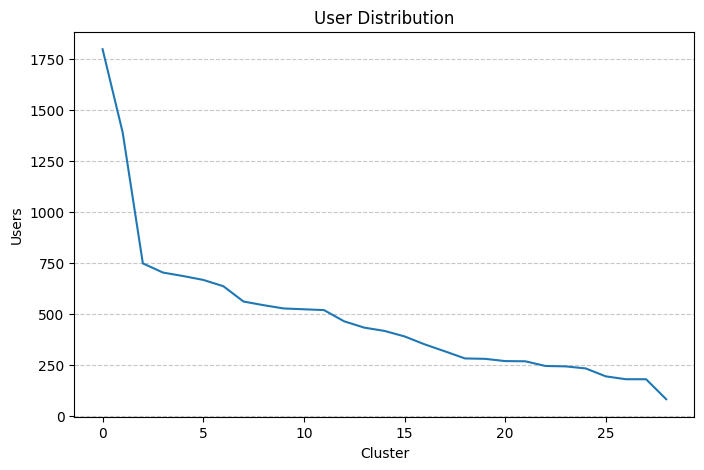

In [183]:
plt.clf()
# Plot
plt.figure(figsize=(8, 5))
plt.plot(sorted(user_per_cluster, reverse=True))
plt.xlabel('Cluster')
plt.ylabel('Users')
plt.title('User Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Show the plot
plt.show()

<Figure size 640x480 with 0 Axes>

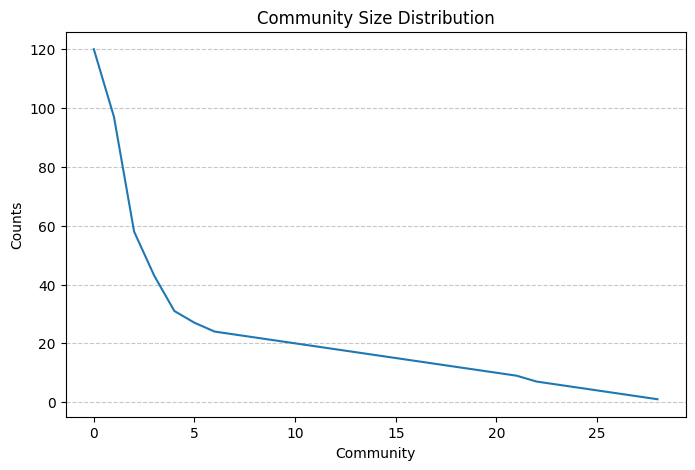

In [172]:
plt.clf()
asd = pd.DataFrame()
value_counts = comms_with_one
# Plot
plt.figure(figsize=(8, 5))
plt.plot(sorted(comms_with_one, reverse=True))
plt.xlabel('Community')
plt.ylabel('Counts')
plt.title('Community Size Distribution')
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Show the plot
plt.show()

In [198]:
def get_neis_comms(graph, not_in):
    dict_user = dict()
    for user in graph.vs():
        cluster_ = user["cls"]
        if not cluster_ in not_in:
            neis_user = list(graph.vs.select(cls_eq=cluster_)["id"])
            neis_user = set([int(x[1:]) for x in neis_user])
            dict_user[int(user["id"][1:])] = neis_user
    return dict_user

In [199]:
comms_with_one = [i for i, subgraph in enumerate(comms.subgraphs()) if len(subgraph.vs) <= 5]
dict_res_comms = get_neis_comms(g, comms_with_one)
dict_res_comms

{1: {1,
  4,
  6,
  8,
  9,
  16,
  35,
  36,
  37,
  38,
  39,
  42,
  43,
  49,
  51,
  53,
  57,
  63,
  67,
  71,
  72,
  73,
  74,
  76,
  78,
  79,
  80,
  81,
  82,
  83,
  84,
  88,
  90,
  91,
  92,
  95,
  104,
  106,
  114,
  147,
  152,
  155,
  172,
  175,
  184,
  187,
  189,
  191,
  193,
  195,
  196,
  197,
  198,
  199,
  200,
  212,
  230,
  232,
  234,
  248,
  249,
  253,
  258,
  277,
  284,
  289,
  290,
  291,
  292,
  293,
  302,
  316,
  326,
  341,
  347,
  350,
  354,
  358,
  364,
  373,
  467,
  468,
  472,
  482,
  494,
  501,
  505,
  507,
  511,
  512,
  514,
  517,
  518,
  523,
  537,
  550,
  562,
  571,
  586,
  608,
  617,
  630,
  632,
  637,
  639,
  640,
  657,
  672,
  693,
  710,
  722,
  725,
  729,
  730,
  733,
  757,
  766,
  778,
  779,
  783,
  816,
  821,
  822,
  834,
  855,
  861,
  862,
  867,
  898,
  916,
  917,
  918,
  921,
  922,
  923,
  925,
  926,
  927,
  930,
  931,
  932,
  933,
  934,
  936,
  955,
  958,
  960,
  1000,
 

In [200]:
def jaccard_sim(dict_kmodes, dict_louvain):
    dict_resul = {}
    total_mean = []
    for key_, item_ in dict_kmodes.items():
        if key_ in dict_louvain.keys():
            intersec = item_.intersection(dict_louvain[key_])
            set_union = item_.union(dict_louvain[key_])
            jacc_index = len(intersec) / len(set_union)
            dict_resul[key_] = jacc_index
            total_mean.append(jacc_index)
        else:
            continue
    return dict_resul, total_mean

In [201]:
dict_result, jacc_list = jaccard_sim(dict_res, dict_res_comms)


In [204]:
dict_res

{12611: {16384,
  10241,
  10240,
  12289,
  16388,
  14341,
  10244,
  16390,
  10246,
  14345,
  11806,
  10252,
  16397,
  14351,
  12306,
  14357,
  16410,
  14362,
  12314,
  16412,
  10274,
  12325,
  16422,
  10280,
  12329,
  12330,
  10283,
  14382,
  16439,
  10298,
  10302,
  14398,
  12351,
  10305,
  14400,
  10316,
  12364,
  13855,
  12368,
  12370,
  10324,
  10330,
  14433,
  12386,
  16487,
  16488,
  10345,
  10347,
  14444,
  16495,
  10353,
  14450,
  10360,
  10364,
  14461,
  10366,
  10367,
  10368,
  16515,
  10372,
  10373,
  12423,
  10375,
  16521,
  16522,
  10380,
  16526,
  12430,
  14480,
  14481,
  16532,
  10389,
  10394,
  16540,
  14493,
  10398,
  12448,
  14497,
  14504,
  10412,
  10420,
  12469,
  10422,
  10424,
  14526,
  10435,
  14534,
  14535,
  10440,
  10439,
  10442,
  16591,
  16592,
  10449,
  12498,
  10450,
  12499,
  12502,
  16599,
  12504,
  12503,
  16600,
  10463,
  16607,
  12517,
  14565,
  12518,
  10473,
  10474,
  16619,
  1

In [203]:
jacc_list

[]

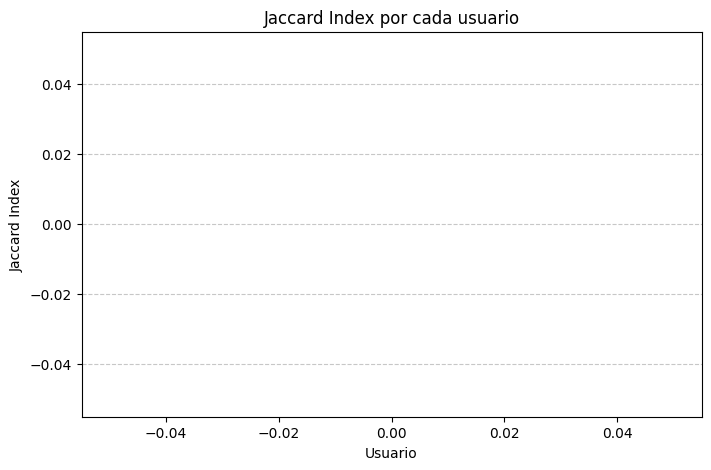

In [202]:
# Extraer claves y valores
# Crear la figura
plt.figure(figsize=(8, 5))
#plt.bar(keys, values, color='skyblue', edgecolor='black')
plt.plot(sorted(jacc_list), color='red')
# Etiquetas y título
plt.xlabel('Usuario')
plt.ylabel('Jaccard Index')
plt.title('Jaccard Index por cada usuario')
plt.xticks(rotation=0)  # Mantiene las etiquetas horizontales
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Mostrar el gráfico
plt.show()

In [190]:
list_cluster_check = []
for i in range(max(df_pos["cls"])):
    temp = df_pos[df_pos["cls"]==i]
    if len(temp["rname"].drop_duplicates()) < 500:
        list_cluster_check.append(i)

list_cluster_check = set(list_cluster_check)
list_cluster_check, len(list_cluster_check)

({3, 6, 8, 9, 10, 12, 13, 16, 18, 19, 20, 21, 22, 23, 25, 26, 27}, 17)

In [191]:
### Implementar la función para obtener todos los vecinos

def get_neis(data, cluster_avoid):
    """Get the nodes in the same cluster."""
    dict_user = dict()
    dict_res = dict()
    for user in data.uname.drop_duplicates():
        all_clusters = set(data[data.uname==user]["cls"])
        all_clusters = all_clusters.difference(cluster_avoid)
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["uname"]))
        dict_user[user] = neis_user
    
    for res in data.rname.drop_duplicates():
        all_clusters = set(data[data.rname==res]["cls"])
        all_clusters = all_clusters.difference(cluster_avoid)
        neis_user = set()
        for cls in all_clusters:
            neis_user = neis_user.union(set(data[data.cls==cls]["rname"]))
        dict_res[res] = neis_user
    
    return dict_user, dict_res

dict_user, dict_res = get_neis(df_pos, list_cluster_check)